In [2]:
import pandas as pd
import os
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
plt.style.use("seaborn-whitegrid")
import numpy as np
# import plotly.express as px

In [3]:
# import sys
# sys.path.append("../../../lib")
# from juan import *

In [4]:
plt.rcParams.update({
    "text.usetex": True,
    "font.family": "sans-serif",
    "font.sans-serif": ["Helvetica"],
    'figure.dpi':900
})

In [5]:
def show(x, n = 5):
    print(x.shape)
    return x.head(n)

In [6]:
models = os.listdir("data")
len(models)

70

In [7]:
data = pd.concat(
    [pd.read_csv("data/" + m).assign(model = m[:-4]) for m in tqdm(models)]
).reset_index(drop = True)
show(data)

  0%|          | 0/70 [00:00<?, ?it/s]

(748, 10)


,column,test_accuracy,test_f1,test_precision,test_recall,train_accuracy,train_f1,train_precision,train_recall,model
0,benefits,0.9,0.0,0.0,0.0,1.000,0.0,0.0,0.0,beto_mtl_weighed_e_2_test
1,culture,0.7,0.0,0.0,0.0,0.675,0.0,0.0,0.0,beto_mtl_weighed_e_2_test
2,dehumanisation,0.3,0.0,0.0,0.0,0.325,0.0,0.0,0.0,beto_mtl_weighed_e_2_test
3,economic,0.9,0.0,0.0,0.0,1.000,0.0,0.0,0.0,beto_mtl_weighed_e_2_test
4,health,1.0,0.0,0.0,0.0,1.000,0.0,0.0,0.0,beto_mtl_weighed_e_2_test


In [8]:
data.model.value_counts()

beto_mtl_weighed_e_2_test                     11
beto_mtl_weighed_e_20_test                    11
beto_mtl_weighed_e_1                          11
mm_bert-base-multilingual-uncased_mtl_e_15    11
beto_mtl_weighed_e_10_test                    11
                                              ..
beto_e_3                                      10
beto_e_3_balanced                             10
rf_char                                       10
beto_e_10                                     10
rf_word                                       10
Name: model, Length: 70, dtype: int64

In [9]:
# data = data.loc[(data.model.str.contains("beto_mtl_e_17") | data.model.str.contains("roberta-base-bne_mtl_e_17")  | data.model.str.contains("roberta-base-bne_mtl_e_15") )]

In [10]:
pivot = data.pivot_table(index = "model", columns = "column", values = "test_f1")\
.assign(mean = lambda df:df.mean(axis = 1))\
.sort_values("task_1", ascending = False)
pivot

column,benefits,culture,dehumanisation,economic,health,migration,others,security,suffering,task_1,xenophobia,mean
model,,,,,,,,,,,,
mm_bert-base-multilingual-uncased_mtl_e_22,0.656739,0.370079,0.103941,0.606646,0.317143,0.641782,0.264428,0.431023,0.311746,0.978947,0.0,0.425680
beto_mtl_e_17,0.669893,0.421845,0.113095,0.512734,0.360000,0.650417,0.209111,0.499345,0.285602,0.968421,0.2,0.444588
mm_bert-base-multilingual-uncased_mtl_e_17,0.651129,0.395724,0.120392,0.498222,0.317143,0.629483,0.061625,0.462579,0.306206,0.968421,0.2,0.419175
mm_bert-base-multilingual-uncased_mtl_e_20,0.612853,0.420352,0.137577,0.574105,0.297143,0.626155,0.102706,0.438107,0.262558,0.957895,0.0,0.402677
beto_mtl_e_15,0.683815,0.448269,0.224608,0.534103,0.273333,0.653947,0.231449,0.479513,0.332172,0.957895,0.0,0.438100
...,...,...,...,...,...,...,...,...,...,...,...,...
lr_word,0.537995,0.265892,0.061818,0.480263,0.354286,0.482830,0.197444,0.324491,0.237101,NaN,0.0,0.294212
rf_char,0.037209,0.116948,0.000000,0.344762,0.180000,0.173420,0.000000,0.067086,0.116484,NaN,0.0,0.103591
rf_word,0.165389,0.152292,0.000000,0.309615,0.180000,0.196215,0.000000,0.045003,0.166484,NaN,0.0,0.121500


In [11]:
to_drop = data.model.str.contains("test")|data.model.str.contains("frozen")
data = data.loc[~to_drop]
show(data)

(522, 10)


,column,test_accuracy,test_f1,test_precision,test_recall,train_accuracy,train_f1,train_precision,train_recall,model
22,benefits,0.963845,0.635018,0.730995,0.596639,0.996660,0.968140,0.978786,0.959728,mm_bert-base-multilingual-uncased_mtl_e_5
23,culture,0.942635,0.387302,0.564000,0.381175,0.988931,0.885747,0.922314,0.873089,mm_bert-base-multilingual-uncased_mtl_e_5
24,dehumanisation,0.980351,0.000000,0.000000,0.000000,0.988277,0.479452,0.899231,0.359462,mm_bert-base-multilingual-uncased_mtl_e_5
25,economic,0.987686,0.486459,0.599394,0.469744,0.997773,0.920474,0.942561,0.902608,mm_bert-base-multilingual-uncased_mtl_e_5
26,health,0.995809,0.160000,0.200000,0.133333,0.998101,0.737647,0.916818,0.636740,mm_bert-base-multilingual-uncased_mtl_e_5


In [12]:
# df.sort_values("test_f1", ascending = False)\
# .reset_index()\
# .assign(model_clean = lambda df: df.model.str.replace(r"_e_[0-9]+", "", regex = True))\
# .sort_values(["model_clean", "test_f1"], ascending = False)\
# .groupby("model_clean").head(1)

# df

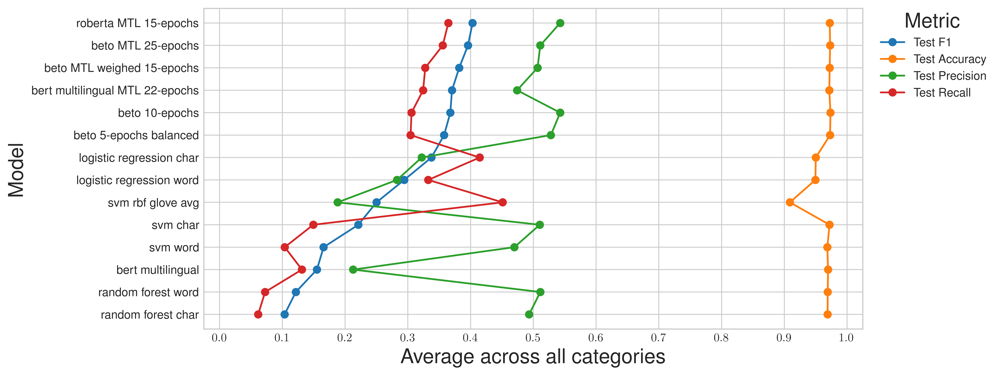

In [28]:
plt.figure(figsize=(10, 5))
df = data.query("column !='task_1'").groupby("model")\
[["test_f1", "test_accuracy", "test_precision", "test_recall"]].mean()\
.reset_index()\
.assign(
    model_clean = lambda df: df.model.str.replace(
        r"_e_[0-9]+", 
        "", 
        regex = True
    )
)\
.sort_values(["model_clean", "test_f1"], ascending = False)\
.groupby("model_clean").head(1)\
.drop(columns = "model_clean")\
.assign(
    model = lambda t: t.model.str.lower()\
    .str.replace("[_-]", " ", regex = True)\
    .str.replace(" e ([0-9]+)", " \\1-epochs", regex = True)\
    .str.replace("lr", "logistic regression")\
    .str.replace("rf", "random forest")\
#     .str.replace("svm", "support vector machine")\
    .str.replace(r"(mm|base|bne|uncased) *", "", regex = True)\
    .str.replace("mtl", "MTL")
)\
.set_index("model")\
.sort_values("test_f1", ascending = True)
# .tail(30)

for c in df.columns:
    plt.plot(
        df[c], 
        df.index, 
        "v-" if "MTL" in c else "o-", 
        label = " ".join([s.capitalize() for s in c.split("_")])
    )
plt.legend(
    bbox_to_anchor=(1.02, 1), 
    loc = 'upper left', 
    borderaxespad = 0, 
    title = "Metric", 
    title_fontsize = "xx-large"
)
plt.xlabel("Average across all categories", fontsize = "xx-large")
plt.ylabel("Model", fontsize = "xx-large")
plt.xticks(np.linspace(0, 1, 11))
plt.xlim(-0.025, 1.025)
plt.show()


In [14]:
plot_models = [
    'mm_bert-base-multilingual-uncased_mtl_e_22',
    'beto_mtl_e_17',
    'mm_roberta-base-bne_mtl_e_10',
    'mm_roberta-base-bne_mtl_e_15',
    'mm_roberta-base-bne_mtl_e_17',
    'beto_mtl_e_20',
    'beto_e_15',
    'svm_char',
    'lr_char',
    'rf_char',
    'rf_word',
    'svm_word',
    'lr_word'
]

plot_names = [
 'BERT multilingual MTL$_{22}$',
 'BETO MTL$_{17}$',
 'RoBERTa MTL$_{10}$',
 '\\textbf{RoBERTa MTL$_{15}$}',
 '\\textbf{RoBERTa MTL$_{17}$}',
 '\\textbf{BETO MTL$_{20}$}',
 'BETO$_{15}$',
 'SVM$_{char}$',
 'LR$_{char}$',
 'RF$_{char}$',
 'RF$_{word}$',
 'SVM$_{word}$',
 'LR$_{word}$'
]

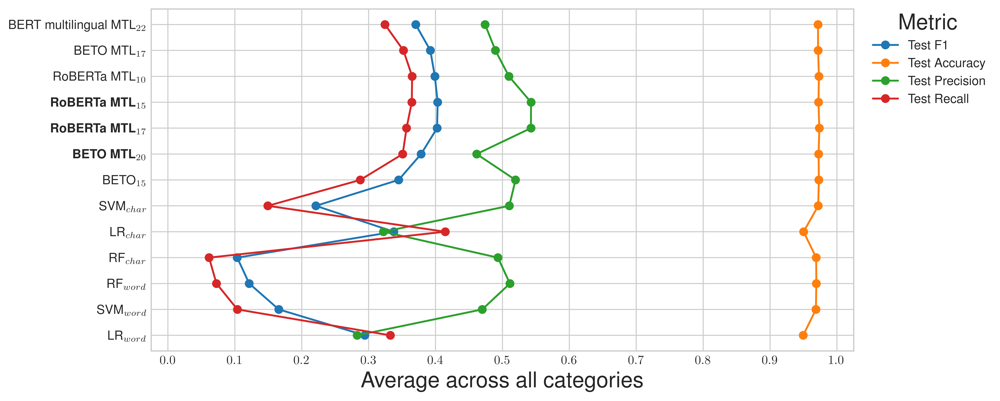

In [15]:
df = data.query("model in @plot_models").query("column !='task_1'")\
.groupby("model")\
[["test_f1", "test_accuracy", "test_precision", "test_recall"]].mean()\
.loc[reversed(plot_models)]\
.assign(plot_name = list(reversed(plot_names)))\
.set_index("plot_name")\

plt.figure(figsize=(10, 5))

for c in df.columns:
    plt.plot(
        df[c], 
        df.index, 
        "v-" if "MTL" in c else "o-", 
        label = " ".join([s.capitalize() for s in c.split("_")])
    )
plt.legend(
    bbox_to_anchor=(1.02, 1), 
    loc = 'upper left', 
    borderaxespad = 0, 
    title = "Metric", 
    title_fontsize = "xx-large"
)
plt.xlabel("Average across all categories", fontsize = "xx-large")
# plt.ylabel("Model", fontsize = "xx-large")
plt.xticks(np.linspace(0, 1, 11))
plt.xlim(-0.025, 1.025)
# plt.show()
plt.savefig("task2_average.pdf", dpi = 900, format = "pdf")

In [16]:
print(df.loc[plot_names].to_latex(float_format = "%.3f"))

\begin{tabular}{lrrrr}
\toprule
{} &  test\_f1 &  test\_accuracy &  test\_precision &  test\_recall \\
plot\_name                    &          &                &                 &              \\
\midrule
BERT multilingual MTL\$\_\{22\}\$ &    0.370 &          0.972 &           0.474 &        0.324 \\
BETO MTL\$\_\{17\}\$              &    0.392 &          0.972 &           0.490 &        0.352 \\
RoBERTa MTL\$\_\{10\}\$           &    0.399 &          0.973 &           0.510 &        0.365 \\
\textbackslash textbf\{RoBERTa MTL\$\_\{15\}\$\}  &    0.403 &          0.972 &           0.543 &        0.364 \\
\textbackslash textbf\{RoBERTa MTL\$\_\{17\}\$\}  &    0.402 &          0.974 &           0.543 &        0.357 \\
\textbackslash textbf\{BETO MTL\$\_\{20\}\$\}     &    0.378 &          0.973 &           0.461 &        0.351 \\
BETO\$\_\{15\}\$                  &    0.345 &          0.973 &           0.519 &        0.288 \\
SVM\$\_\{char\}\$                 &    0.221 &          0.97

/tmp/ipykernel_2922043/536563138.py:1: FutureWarning: In future versions `DataFrame.to_latex` is expected to utilise the base implementation of `Styler.to_latex` for formatting and rendering. The arguments signature may therefore change. It is recommended instead to use `DataFrame.style.to_latex` which also contains additional functionality.
  print(df.loc[plot_names].to_latex(float_format = "%.3f"))


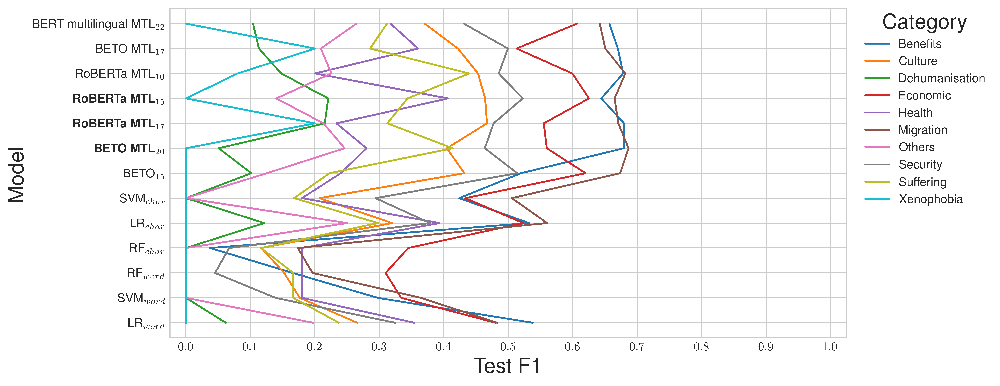

In [32]:
metric = "test_f1"

df = data.query("model in @plot_models").query("column !='task_1'")\
.pivot("model", "column", metric)\
.loc[reversed(plot_models)]\
.assign(plot_name = list(reversed(plot_names)))\
.set_index("plot_name")\

plt.figure(figsize=(10, 5))

for c in df.columns:
    plt.plot(df[c], df.index, "-", label = c.capitalize())

plt.legend()
plt.legend(
    bbox_to_anchor=(1.02, 1), 
    loc='upper left', 
    borderaxespad=0,
    title = "Category",
    title_fontsize = "xx-large"
)
plt.xlim(-0.025, 1.025)
plt.xticks(np.linspace(0, 1, 11))
plt.xlabel("Test F1", fontsize = "xx-large")
plt.ylabel("Model", fontsize = "xx-large")
plt.show()

In [18]:
print(
    df.loc[plot_names].reset_index()\
#     .assign(plot_name = lambda df:df.plot_name.map(lambda x: x.replace(r"\", "")))\
    .iloc[:, :5].to_latex(float_format = "%.3f")
)

\begin{tabular}{llrrrr}
\toprule
column &                     plot\_name &  benefits &  culture &  dehumanisation &  economic \\
\midrule
0  &  BERT multilingual MTL\$\_\{22\}\$ &     0.657 &    0.370 &           0.104 &     0.607 \\
1  &               BETO MTL\$\_\{17\}\$ &     0.670 &    0.422 &           0.113 &     0.513 \\
2  &            RoBERTa MTL\$\_\{10\}\$ &     0.678 &    0.453 &           0.148 &     0.599 \\
3  &   \textbackslash textbf\{RoBERTa MTL\$\_\{15\}\$\} &     0.644 &    0.464 &           0.221 &     0.625 \\
4  &   \textbackslash textbf\{RoBERTa MTL\$\_\{17\}\$\} &     0.679 &    0.467 &           0.215 &     0.555 \\
5  &      \textbackslash textbf\{BETO MTL\$\_\{20\}\$\} &     0.679 &    0.405 &           0.051 &     0.560 \\
6  &                   BETO\$\_\{15\}\$ &     0.520 &    0.432 &           0.101 &     0.620 \\
7  &                  SVM\$\_\{char\}\$ &     0.424 &    0.207 &           0.000 &     0.433 \\
8  &                   LR\$\_\{char\}\$ &     

/tmp/ipykernel_2922043/2430211499.py:2: FutureWarning: In future versions `DataFrame.to_latex` is expected to utilise the base implementation of `Styler.to_latex` for formatting and rendering. The arguments signature may therefore change. It is recommended instead to use `DataFrame.style.to_latex` which also contains additional functionality.
  df.loc[plot_names].reset_index()\


In [19]:
print(df.loc[plot_names].reset_index().iloc[:, 5:].to_latex(float_format = "%.3f"))

\begin{tabular}{lrrrrrr}
\toprule
column &  health &  migration &  others &  security &  suffering &  xenophobia \\
\midrule
0  &   0.317 &      0.642 &   0.264 &     0.431 &      0.312 &       0.000 \\
1  &   0.360 &      0.650 &   0.209 &     0.499 &      0.286 &       0.200 \\
2  &   0.200 &      0.681 &   0.226 &     0.485 &      0.439 &       0.080 \\
3  &   0.407 &      0.665 &   0.140 &     0.522 &      0.344 &       0.000 \\
4  &   0.233 &      0.671 &   0.213 &     0.477 &      0.312 &       0.200 \\
5  &   0.280 &      0.686 &   0.246 &     0.464 &      0.414 &       0.000 \\
6  &   0.240 &      0.674 &   0.125 &     0.514 &      0.223 &       0.000 \\
7  &   0.180 &      0.505 &   0.000 &     0.294 &      0.168 &       0.000 \\
8  &   0.393 &      0.560 &   0.250 &     0.379 &      0.298 &       0.000 \\
9  &   0.180 &      0.173 &   0.000 &     0.067 &      0.116 &       0.000 \\
10 &   0.180 &      0.196 &   0.000 &     0.045 &      0.166 &       0.000 \\
11 &   0.180 &   

/tmp/ipykernel_2922043/3200471035.py:1: FutureWarning: In future versions `DataFrame.to_latex` is expected to utilise the base implementation of `Styler.to_latex` for formatting and rendering. The arguments signature may therefore change. It is recommended instead to use `DataFrame.style.to_latex` which also contains additional functionality.
  print(df.loc[plot_names].reset_index().iloc[:, 5:].to_latex(float_format = "%.3f"))


In [20]:
plt.figure(figsize=(15, 10))
metric = "test_f1"

df = data.pivot("model", "column", metric)\
.drop(columns = "task_1")\
.assign(mean = lambda df: df.iloc[:, 1:].mean(axis = 1))\
.sort_values("mean", ascending = True)\
# .tail(30)

for c in df.columns[:-1]:
    plt.plot(df[c], df.index, "o-", label = c.capitalize())

plt.legend()
plt.legend(
    bbox_to_anchor=(1.02, 1), 
    loc='upper left', 
    borderaxespad=0,
    title = "Category",
    title_fontsize = "x-large"
)
plt.xlim(-0.1, 1.1)
plt.xticks(np.linspace(0, 1, 11))
plt.xlabel("Test F1")
plt.ylabel("Model")
plt.show()

In [21]:
plt.figure(figsize=(15, 10))
metric = "train_f1"

df = data.pivot("model", "column", metric)\
.assign(mean = lambda df: df.iloc[:, 1:].mean(axis = 1))\
.sort_values("mean", ascending = True)\

for c in df.columns[:-1]:
    plt.plot(df[c], df.index, "--", label = c)

plt.legend()
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
plt.xlim(-0.1, 1.1)
plt.xticks(np.linspace(0, 1, 11))
plt.xlabel(metric)
plt.show()

In [22]:
plt.figure(figsize=(15, 10))
metric = "test_accuracy"

df = data.pivot("model", "column", metric)\
.assign(mean = lambda df: df.iloc[:, 1:].mean(axis = 1))\
.sort_values("mean", ascending = True)\

for c in df.columns[:-1]:
    plt.plot(df[c], df.index, "o-", label = c)
    
plt.legend()
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
plt.xlim(-0.1, 1.1)
plt.xticks(np.linspace(0, 1, 11))
plt.xlabel(metric)
plt.show()

In [23]:
plt.figure(figsize=(15, 10))
metric = "train_accuracy"

df = data.pivot("model", "column", metric)\
.assign(mean = lambda df: df.iloc[:, 1:].mean(axis = 1))\
.sort_values("mean", ascending = True)\

for c in df.columns[:-1]:
    plt.plot(df[c], df.index, "--", label = c)
    
plt.legend()
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
plt.xlim(-0.1, 1.1)
plt.xticks(np.linspace(0, 1, 11))
plt.xlabel(metric)
plt.show()

In [24]:
plt.figure(figsize=(15, 10))
metric = "test_precision"

df = data.pivot("model", "column", metric)\
.assign(mean = lambda df: df.iloc[:, 1:].mean(axis = 1))\
.sort_values("mean", ascending = True)\

for c in df.columns[:-1]:
    plt.plot(df[c], df.index, "o-", label = c)
    
plt.legend()
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
plt.xlim(-0.1, 1.1)
plt.xticks(np.linspace(0, 1, 11))
plt.xlabel(metric)
plt.show()

In [25]:
plt.figure(figsize=(15, 10))
metric = "train_precision"

df = data.pivot("model", "column", metric)\
.assign(mean = lambda df: df.iloc[:, 1:].mean(axis = 1))\
.sort_values("mean", ascending = True)\

for c in df.columns[:-1]:
    plt.plot(df[c], df.index, "--", label = c)
    
plt.legend()
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
plt.xlim(-0.1, 1.1)
plt.xticks(np.linspace(0, 1, 11))
plt.xlabel(metric)
plt.show()

In [26]:
plt.figure(figsize=(15, 10))
metric = "test_recall"

df = data.pivot("model", "column", metric)\
.assign(mean = lambda df: df.iloc[:, 1:].mean(axis = 1))\
.sort_values("mean", ascending = True)\

for c in df.columns[:-1]:
    plt.plot(df[c], df.index, "o-", label = c)
    
plt.legend()
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
plt.xlim(-0.1, 1.1)
plt.xticks(np.linspace(0, 1, 11))
plt.xlabel(metric)
plt.show()

In [27]:
plt.figure(figsize=(15, 10))
metric = "train_recall"

df = data.pivot("model", "column", metric)\
.assign(mean = lambda df: df.iloc[:, 1:].mean(axis = 1))\
.sort_values("mean", ascending = True)\

for c in df.columns[:-1]:
    plt.plot(df[c], df.index, "--", label = c)
    
plt.legend()
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
plt.xlim(-0.1, 1.1)
plt.xticks(np.linspace(0, 1, 11))
plt.xlabel(metric)
plt.show()